# Exercise Sheet 9

In [2]:
import numpy as np
import matplotlib.pyplot as plt

## Exercise 1
1. Given the following dataset of 8 data points:
$$
A=\{(1,1),(2,1),(4,3),(5,4),(6,5),(7,6),(9,8),(10,7)\}
$$

Apply the k-means algorithm with $k=2$, starting with the initial centroids $C_1=(2,1)$ and $C_2=(10,7)$. Perform two iterations of the algorithm, showing the assignment of data points to clusters and the updated positions of centroids after each iteration.
2. Now, suppose you want to apply the k-means algorithm with $k=3$ to the same dataset. Choose the initial centroids as $C_1=(1,1), C_2=(5,4)$, and $C_3=(9,8)$. Perform two iterations of the algorithm, showing the assignment of data points to clusters and the updated positions of centroids after each iteration.

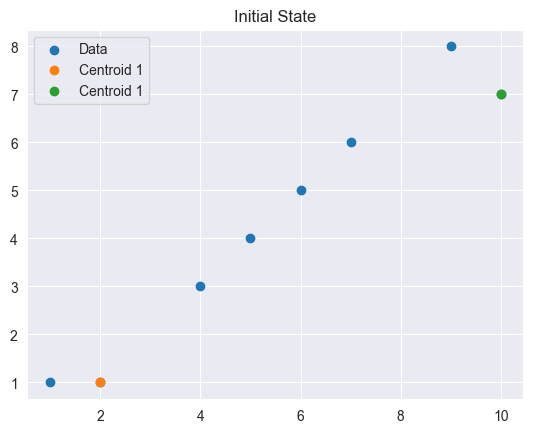

In [11]:
A= np.asarray([(1,1),(2,1),(4,3),(5,4),(6,5),(7,6),(9,8),(10,7)])
plt.scatter(A[:, 0], A[:, 1], label = "Data")
plt.scatter(2, 1, label="Centroid 1")
plt.scatter(10, 7,  label="Centroid 1")
plt.title("Initial State")
plt.legend()
plt.show()

C:\Users\mhuep\AppData\Local\Temp\ipykernel_5044\1291537850.py:53: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', self.n_clusters)


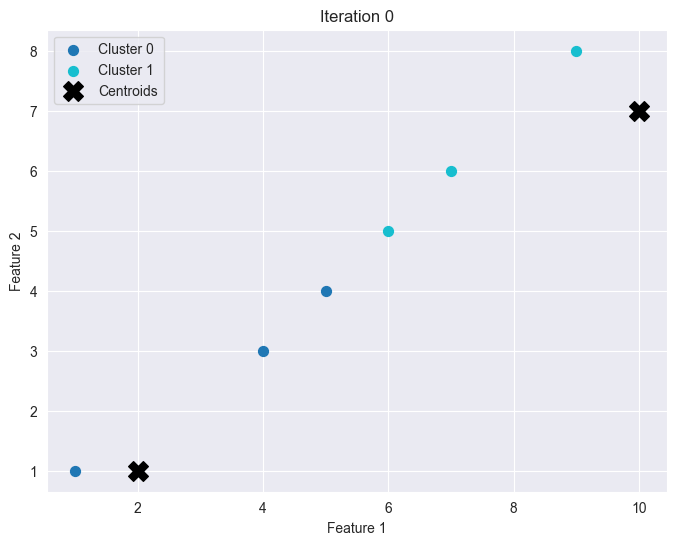

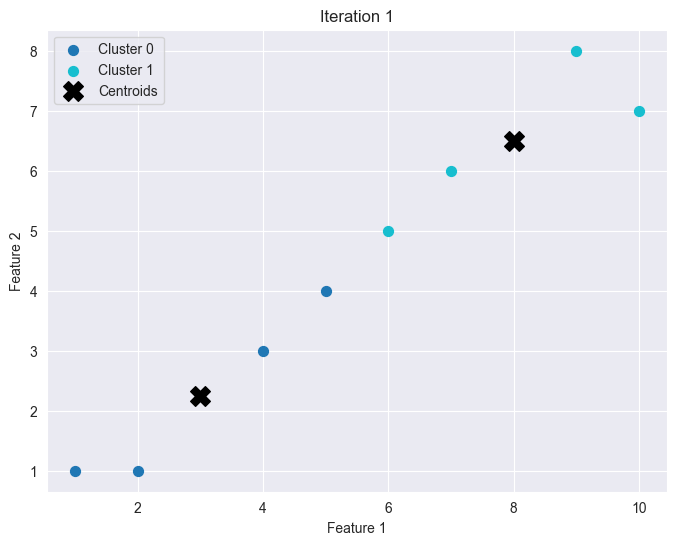

Centroids:
[[3.   2.25]
 [8.   6.5 ]]


In [16]:
class KMeans:
    def __init__(self, n_clusters, centroids,  max_iter=300, tol=1e-4):
        self.n_clusters = n_clusters
        self.max_iter = max_iter
        self.tol = tol
        self.centroids = centroids

    def fit(self, X):
        # Initialize the centroids as random samples from X
        np.random.seed(42)  # For reproducibility

        for i in range(self.max_iter):
            # Assign each point to the nearest centroid
            self.labels = self._assign_labels(X)

            # Compute new centroids as the mean of the points in each cluster
            new_centroids = self._compute_centroids(X)

            # Plot the current state
            self.plot_state(X, i)

            # Check for convergence
            if np.all(np.abs(new_centroids - self.centroids) < self.tol):
                break

            self.centroids = new_centroids

    def _assign_labels(self, X):
        # Compute the distance between each point and each centroid
        distances = np.linalg.norm(X[:, np.newaxis] - self.centroids, axis=2)
        # Assign each point to the nearest centroid
        return np.argmin(distances, axis=1)

    def _compute_centroids(self, X):
        # Compute the mean of the points in each cluster
        centroids = np.zeros((self.n_clusters, X.shape[1]))
        for k in range(self.n_clusters):
            points_in_cluster = X[self.labels == k]
            if len(points_in_cluster) > 0:
                centroids[k] = points_in_cluster.mean(axis=0)
        return centroids

    def predict(self, X):
        # Assign each point to the nearest centroid
        return self._assign_labels(X)

    def fit_predict(self, X):
        self.fit(X)
        return self.labels

    def plot_state(self, X, iteration):
        plt.figure(figsize=(8, 6))
        colors = plt.cm.get_cmap('tab10', self.n_clusters)

        # Plot data points with color corresponding to cluster label
        for k in range(self.n_clusters):
            cluster_points = X[self.labels == k]
            plt.scatter(cluster_points[:, 0], cluster_points[:, 1], s=50, color=colors(k), label=f'Cluster {k}')

        # Plot centroids
        plt.scatter(self.centroids[:, 0], self.centroids[:, 1], s=200, color='black', marker='X', label='Centroids')

        plt.title(f'Iteration {iteration}')
        plt.xlabel('Feature 1')
        plt.ylabel('Feature 2')
        plt.legend()
        plt.show()


# Fit KMeans
kmeans = KMeans(n_clusters=2, centroids=np.asarray([(2, 1), (10,7)]), max_iter=3)
X = np.asarray([(1,1),(2,1),(4,3),(5,4),(6,5),(7,6),(9,8),(10,7)])

kmeans.fit(X)

# Predict cluster labels
labels = kmeans.predict(X)

# Print centroids
print("Centroids:")
print(kmeans.centroids)

C:\Users\mhuep\AppData\Local\Temp\ipykernel_5044\1291537850.py:53: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', self.n_clusters)


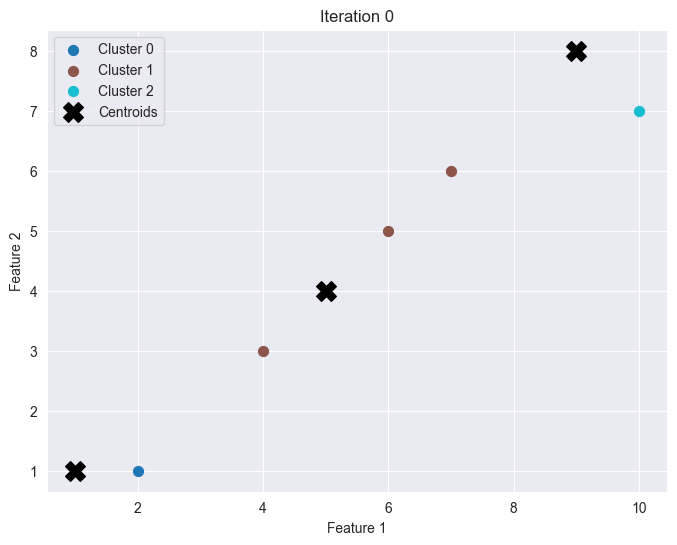

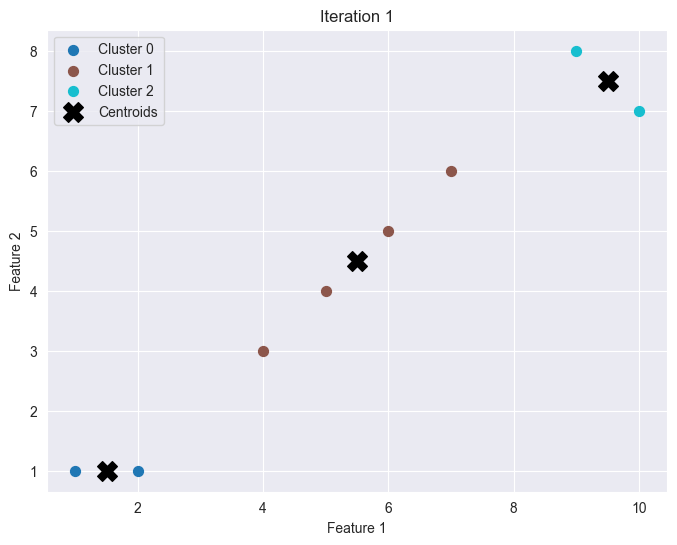

Centroids:
[[1.5 1. ]
 [5.5 4.5]
 [9.5 7.5]]


In [17]:
# Fit KMeans
kmeans = KMeans(n_clusters=3, centroids=np.asarray([(1, 1), (5, 4), (9,8)]), max_iter=3)

kmeans.fit(X)

# Predict cluster labels
labels = kmeans.predict(X)

# Print centroids
print("Centroids:")
print(kmeans.centroids)

## Exercise 2

For the k-means algorithm, a cluster is given as $C_j$. Provide a mathematical proof that the cluster center $\mu_j$ for the cluster $C_j$ minimizes the following equation
$$
\min _{\mu_j} \sum_{x^{(i)} \in C_j}\left\|x^{(i)}-\mu_j\right\|^2
$$
if and only if $\mu_j$ is the centroid of the cluster, i.e.,
$$
\mu_j=\frac{1}{\left|C_j\right|} \sum_{x^{(i)} \in C_j} x^{(i)}
$$

Part 1: If $\mu_j=\frac{1}{\left|C_j\right|} \sum_{x^{(i)} \in C_j} x^{(i)}$, then $\mu_j$ minimizes the sum of squared distances

Let
$$
\mu_j=\frac{1}{\left|C_j\right|} \sum_{x^{(0)} \in C_j} x^{(i)}
$$

We want to minimize the function:
$$
f\left(\mu_j\right)=\sum_{x^{(i)} \in C_j}\left\|x^{(i)}-\mu_j\right\|^2
$$

Expand the squared norm:
$$
\left\|x^{(i)}-\mu_j\right\|^2=\left(x^{(i)}-\mu_j\right)^{\top}\left(x^{(i)}-\mu_j\right) .
$$

Thus,
$$
f\left(\mu_j\right)=\sum_{x^{(i)} \in C_j}\left(x^{(i)}-\mu_j\right)^{\top}\left(x^{(i)}-\mu_j\right)
$$

To find the minimum, we take the derivative of $f\left(\mu_j\right)$ with respect to $\mu_j$ and set it to zero. The derivative is:
$$
\nabla_{\mu_j} f\left(\mu_j\right)=\nabla_{\mu_j} \sum_{x(i) \in C_j}\left(x^{(i)}-\mu_j\right)^{\top}\left(x^{(i)}-\mu_j\right) .
$$

Using the linearity of the gradient and the chain rule, we get:
$$
\nabla_{\mu_j} f\left(\mu_j\right)=\sum_{x^{(i)} \in C_j} \nabla_{\mu_j}\left[\left(x^{(i)}-\mu_j\right)^{\top}\left(x^{(i)}-\mu_j\right)\right] .
$$

We compute the gradient of each term inside the sum:
$$
\nabla_{\mu_j}\left[\left(x^{(i)}-\mu_j\right)^{\top}\left(x^{(i)}-\mu_j\right)\right]=\nabla_{\mu_j}\left[x^{(i) \top} x^{(i)}-2 x^{(i) \top} \mu_j+\mu_j^{\top} \mu_j\right] .
$$

Since $x^{(i) \top} x^{(i)}$ is a constant with respect to $\mu_f$, its gradient is zero. Thus,
$$
\nabla_{\mu_j}\left[\left(x^{(i)}-\mu_j\right)^{\top}\left(x^{(i)}-\mu_j\right)\right]=-2 x^{(i)}+2 \mu_j
$$

Summing these gradients, we get:
$$
\nabla_{\mu j} f\left(\mu_j\right)=\sum_{x(0) \in C_j}\left(-2 x^{(0)}+2 \mu_j\right)
$$

Simplifying.

Setting the gradient to zero to find the critical points,
$$
-2 \sum_{\left.x^{(}\right) \in C_s} x^{(0)}+2\left|C_j\right| \mu_j=0
$$
which simplifies to
$$
\sum_{x^{(0)} \in C_s} x^{(i)}=\left|C_j\right| \mu_j
$$

Thus.
$$
\mu_j=\frac{1}{\left|C_j\right|} \sum_{x\left(\varphi_{\in} \in C_j\right.} x^{(0)}
$$

This shows that $\mu_j=\frac{1}{\left|C_j\right|} \sum_{x^{(\phi)}}^{C C_j} x^{(i)}$ minimizes the sum of squared distances.
Part 2: If $\mu_j$ minimizes the sum of squared distances, then $\mu_j=$ $\frac{1}{\left|C_j\right|} \sum_x^{(0) \in C_y} x^{(i)}$
Assume that $\mu_j$ minimizes
$$
\sum_{x=C_j}\left\|x^{(0)}-\mu_j\right\|^2
$$

From the derivation above, we know that setting the gradient to zero gives the condition:
$$
\sum_{x(0) \in C_j} x^{(i)}=\left|C_j\right| \mu_j
$$

Therefore,
$$
\mu_j=\frac{1}{\left|C_j\right|} \sum_{x^{(9) C C_j}} x^{(0)}
$$

In [2]:
import cv2

def load_img_to_floatarray(image_path):
    """Loads a jpg image as a matrix of shape (n,m,3) where
    n and m are the height and width of the image. Returns a
    numpy array of dtype float."""
    # just the easiest way to do this in this scenario
    # there are more sophisticated libraries for this
    # e.g. CV2 or Pillow, also scipy has a function
    img_matrix = cv2.imread(image_path)

    return img_matrix

In [3]:
def transform_img_KMeans(image, n_clust):
    # transform image into datamatrix with 3 features (RGB)
    # calculate k means cluster
    # replace data points with cluster centers
    # return reshaped image
    # Reshape the image to a 2D array of pixels
    pixels = image.reshape(-1, 3)

    # Fit KMeans to the pixel data
    kmeans = KMeans(n_clusters=n_clust, random_state=42).fit(pixels)

    # Replace each pixel with its nearest cluster center
    new_pixels = kmeans.cluster_centers_[kmeans.predict(pixels)]

    # Reshape the new pixel data to the original image shape
    compressed_image = new_pixels.reshape(image.shape)

    return compressed_image, kmeans.cluster_centers_

## k-means based compression

Compressing image 1


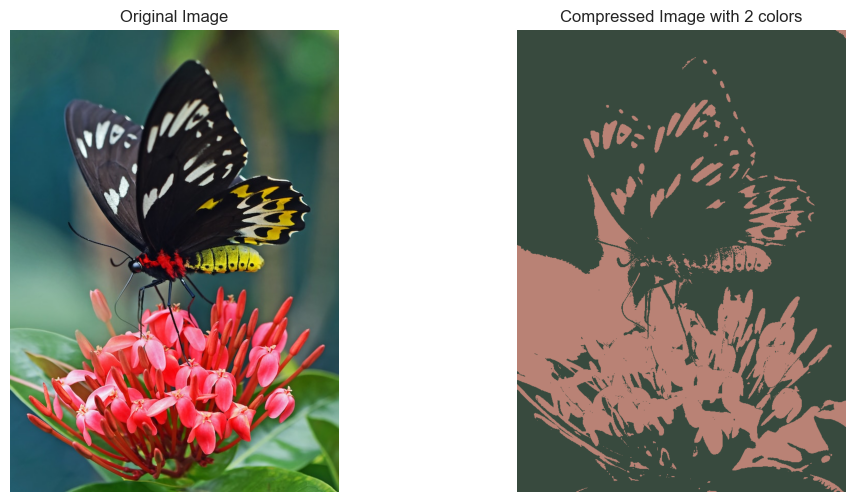

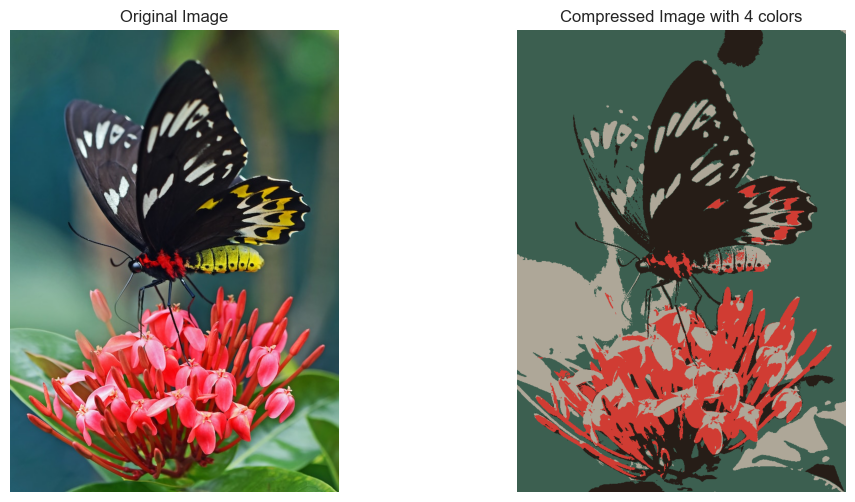

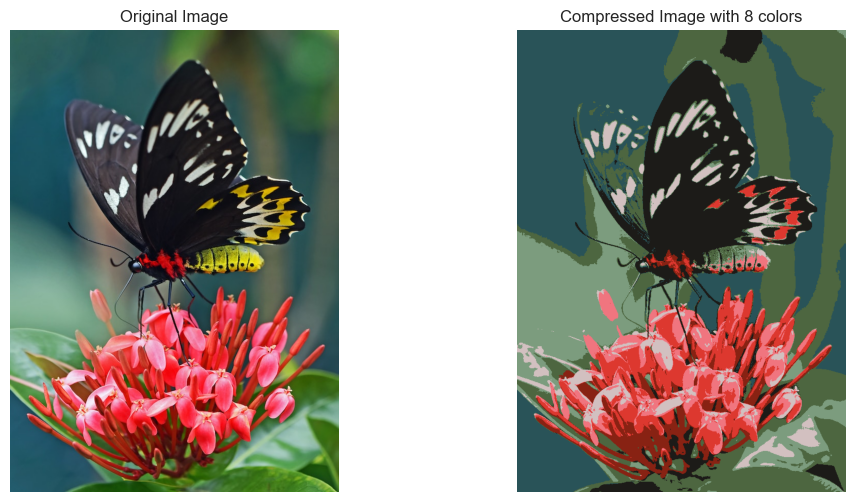

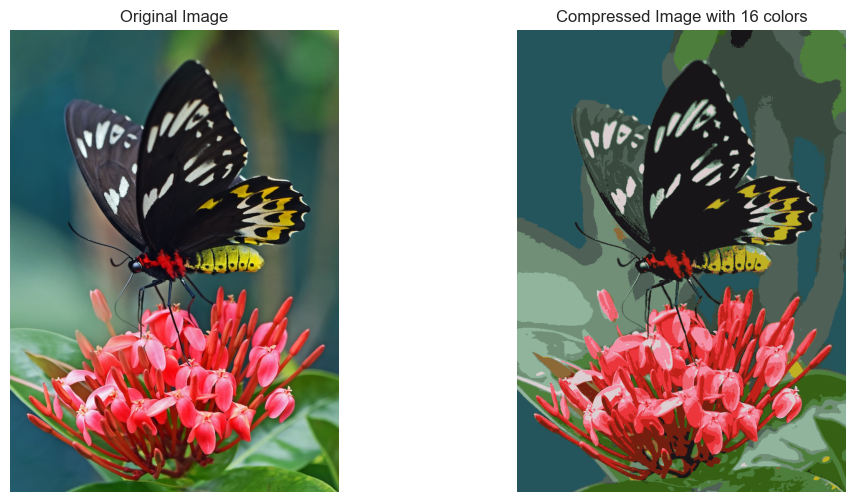

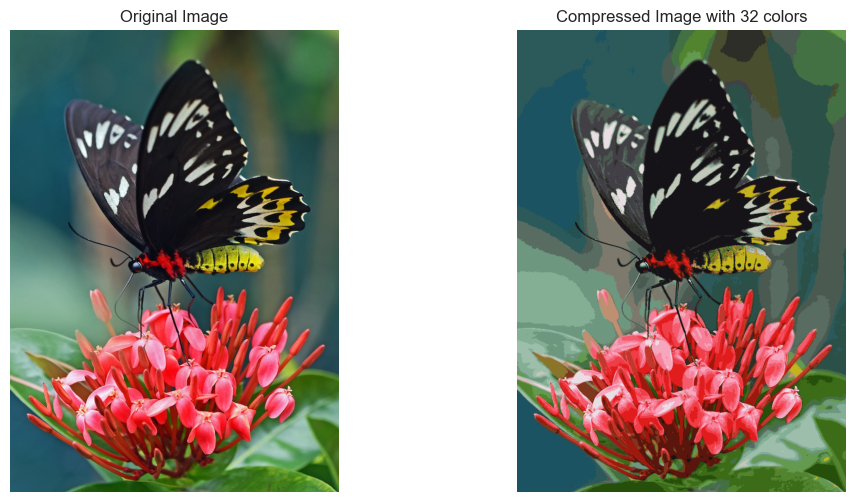

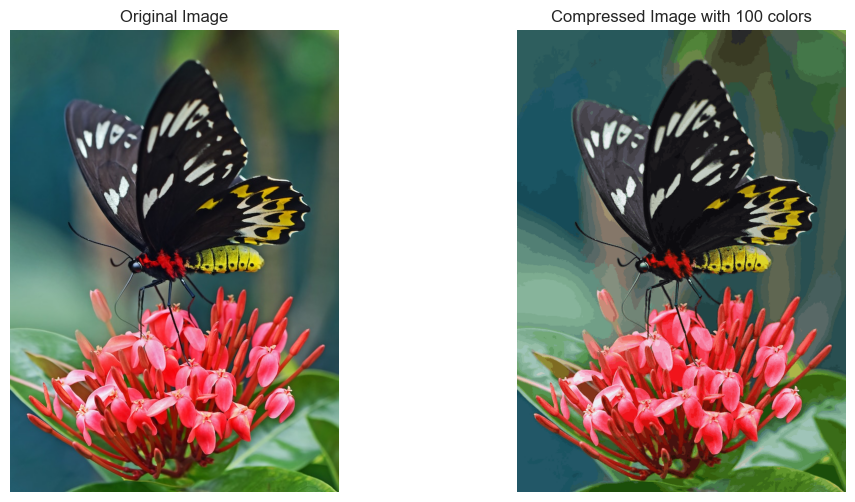

Compressing image 2


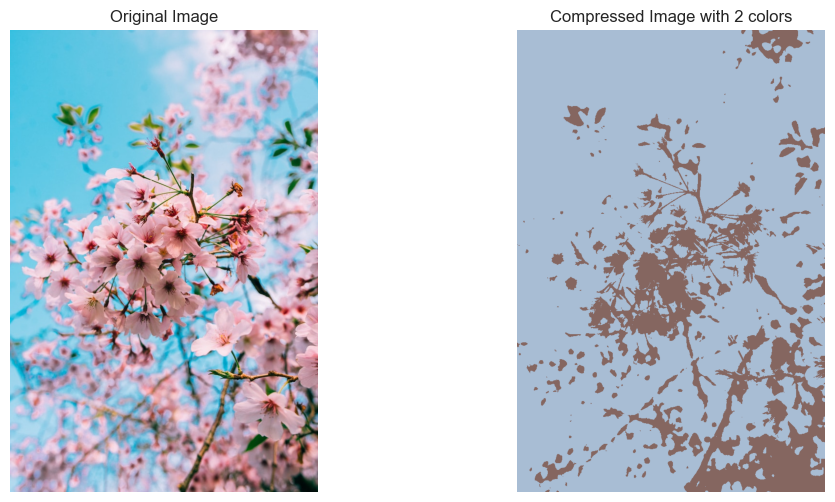

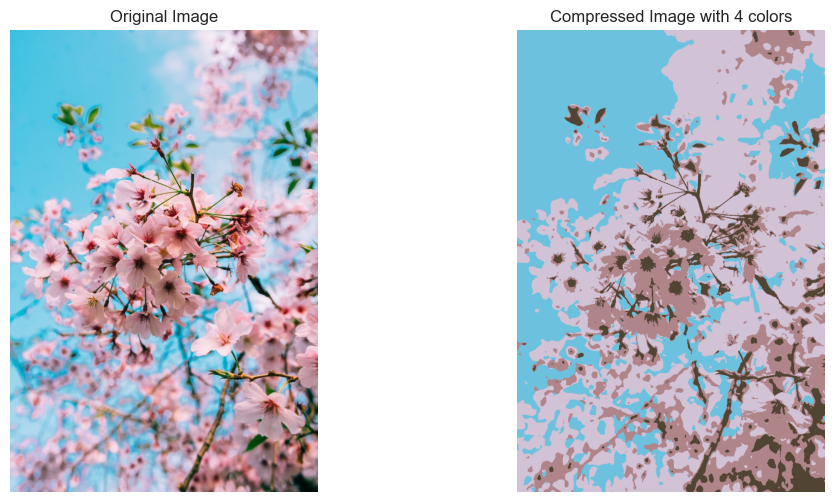

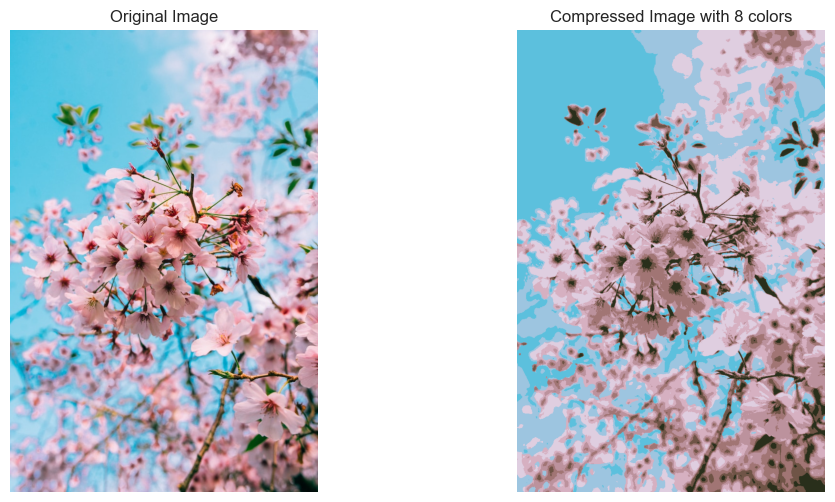

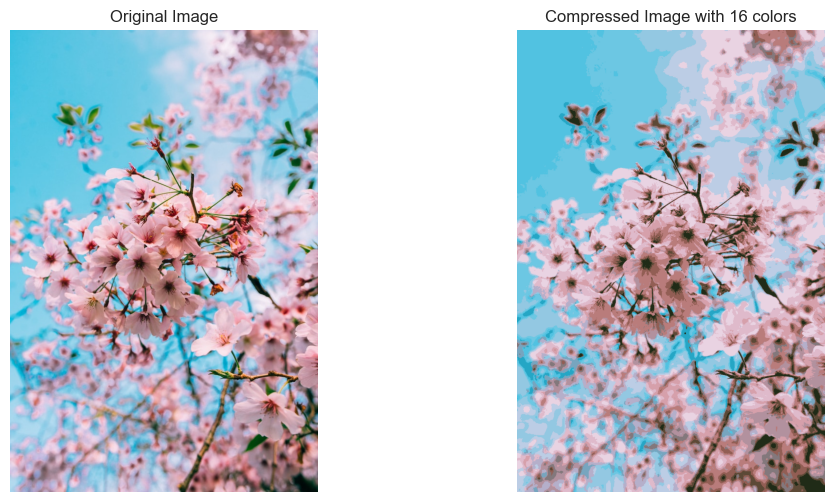

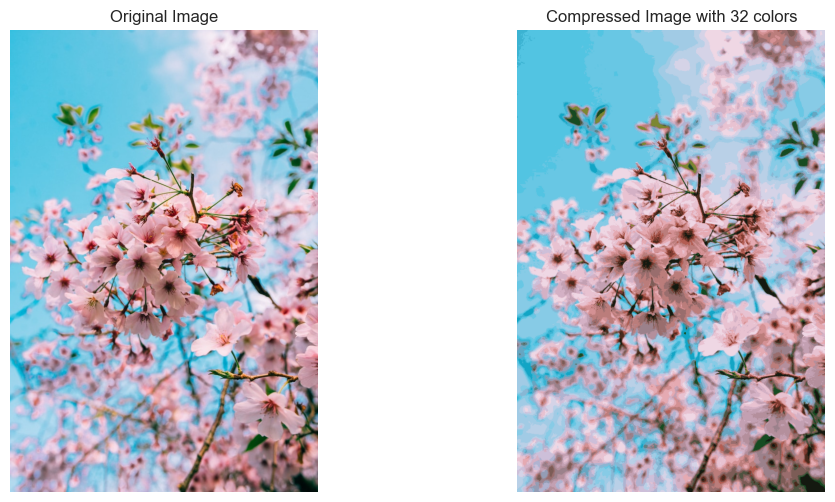

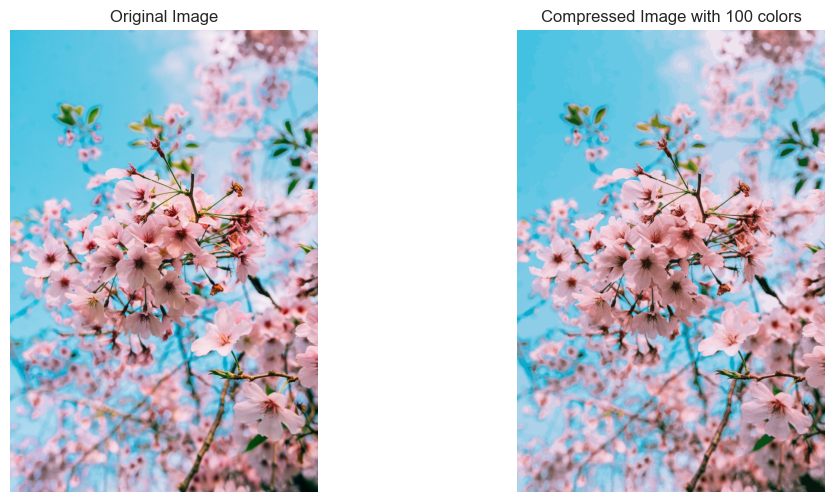

Compressing image 3


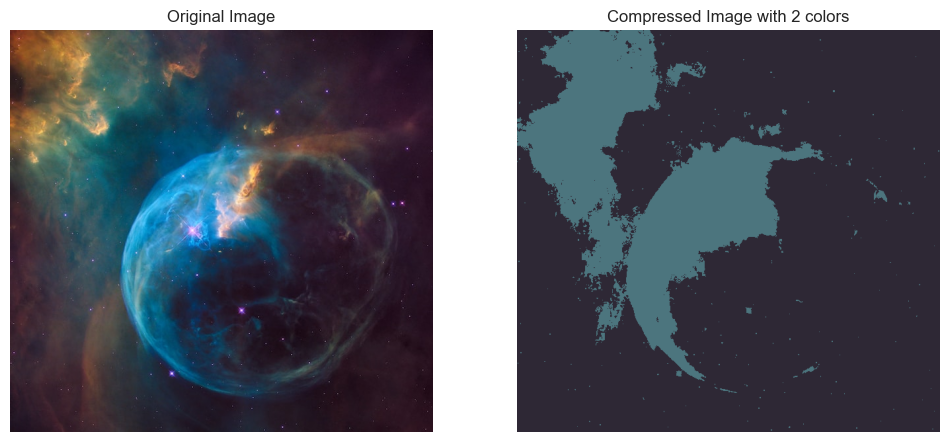

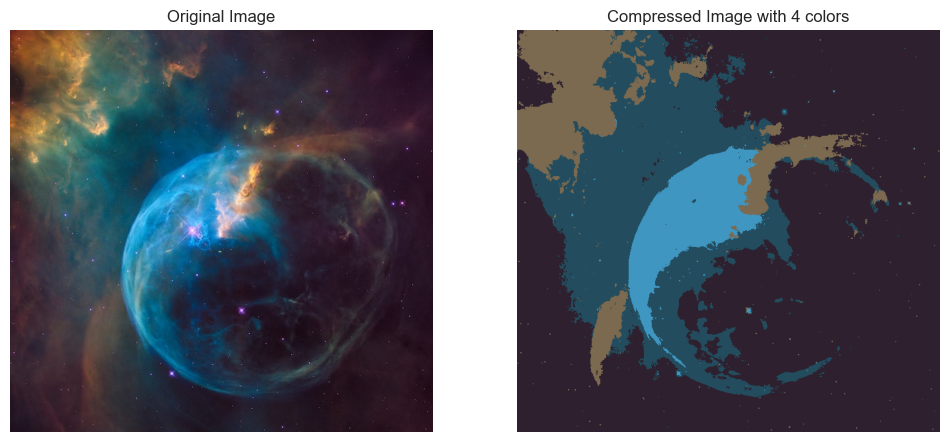

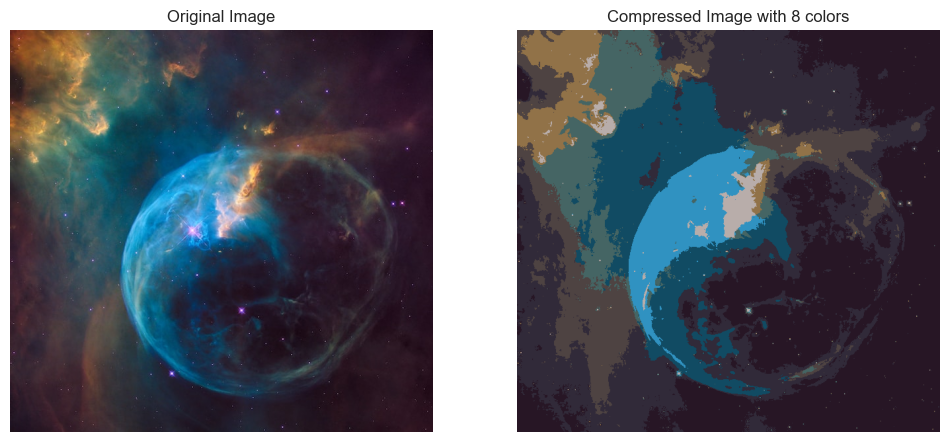

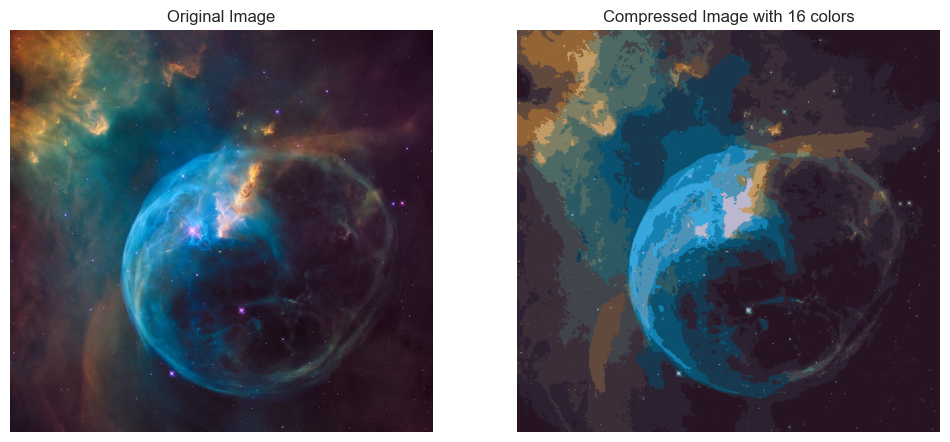

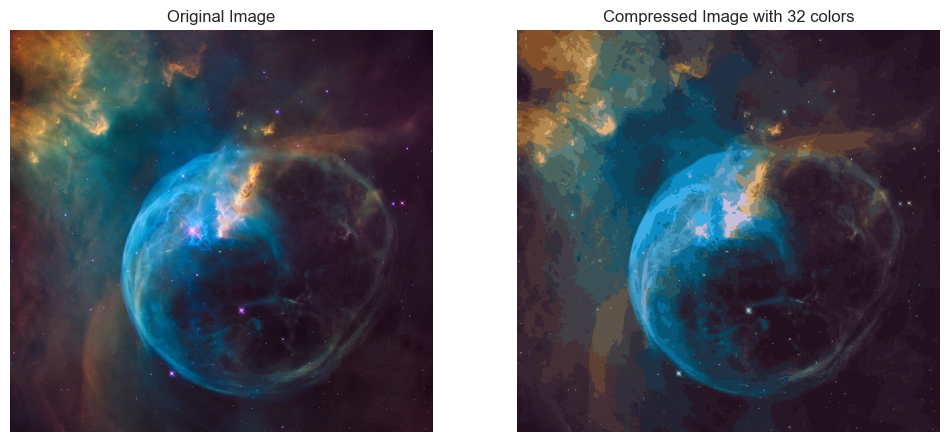

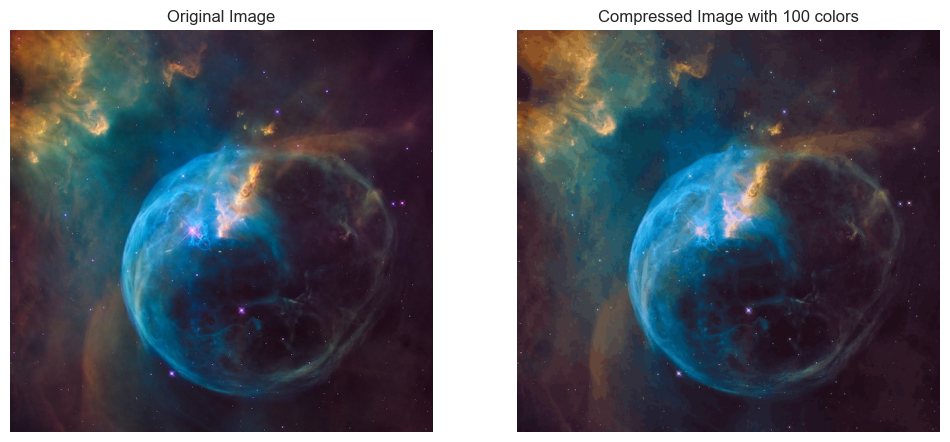

In [22]:
# load images
from sklearn.cluster import KMeans
import cv2

def compress_image(image, n_clusters):
    # Reshape the image to a 2D array of pixels
    pixels = image.reshape(-1, 3)

    # Fit KMeans to the pixel data
    kmeans = KMeans(n_clusters=n_clusters, random_state=42).fit(pixels)

    # Replace each pixel with its nearest cluster center
    new_pixels = kmeans.cluster_centers_[kmeans.predict(pixels)]

    # Reshape the new pixel data to the original image shape
    compressed_image = new_pixels.reshape(image.shape)

    return compressed_image, kmeans.cluster_centers_

def plot_images(original, compressed, n_clusters):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(original)
    axes[0].set_title('Original Image')
    axes[0].axis('off')

    axes[1].imshow(compressed.astype(np.uint8))
    axes[1].set_title(f'Compressed Image with {n_clusters} colors')
    axes[1].axis('off')

    plt.show()

# Load the images
image1 = cv2.imread('butterfly.jpg')
image2 = cv2.imread('flower.jpg')
image3 = cv2.imread('nasa.jpg')

images = [image1, image2, image3]
images = [cv2.cvtColor(img, cv2.COLOR_BGR2RGB) for img in images]
# Number of clusters to try
cluster_sizes = [2, 4, 8, 16, 32, 100]

for i, image in enumerate(images):
    print(f"Compressing image {i+1}")
    for n_clusters in cluster_sizes:
        compressed_image, _ = compress_image(image, n_clusters)
        plot_images(image, compressed_image, n_clusters)


For the first 16 is fine, the second requires 32 and the last 100 to successfully represent the original image after compression.

## PCA based compression

Compressing image 1


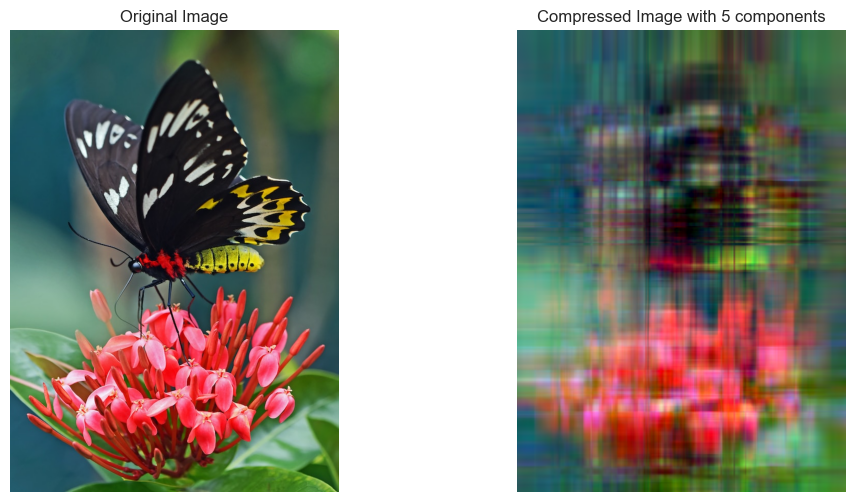

Number of components: 5
Explained variance ratios for R channel: 0.7292
Explained variance ratios for G channel: 0.5066
Explained variance ratios for B channel: 0.4748


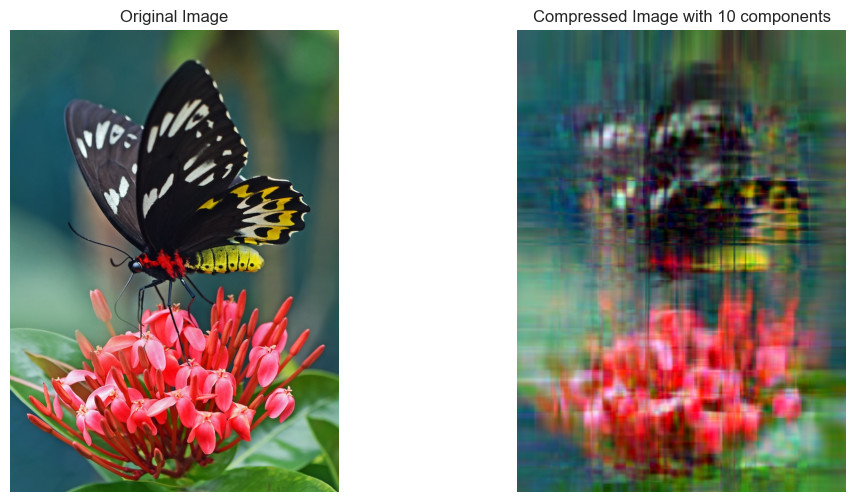

Number of components: 10
Explained variance ratios for R channel: 0.8110
Explained variance ratios for G channel: 0.6597
Explained variance ratios for B channel: 0.6508


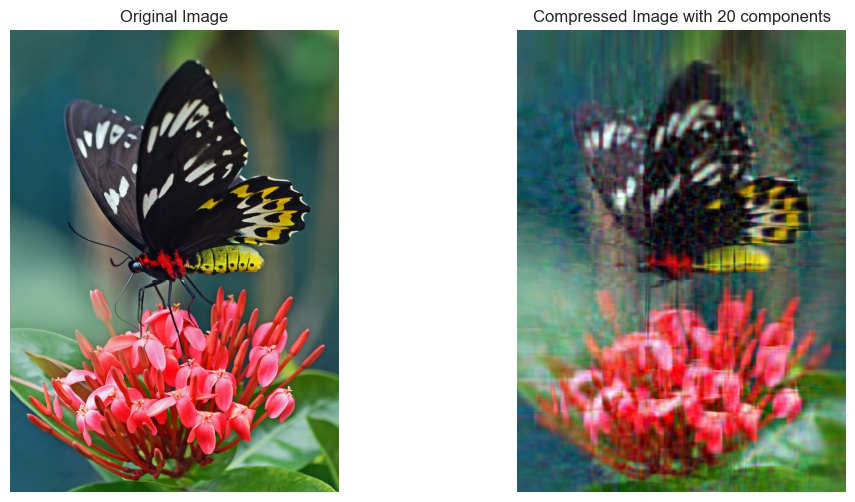

Number of components: 20
Explained variance ratios for R channel: 0.8929
Explained variance ratios for G channel: 0.8014
Explained variance ratios for B channel: 0.8047


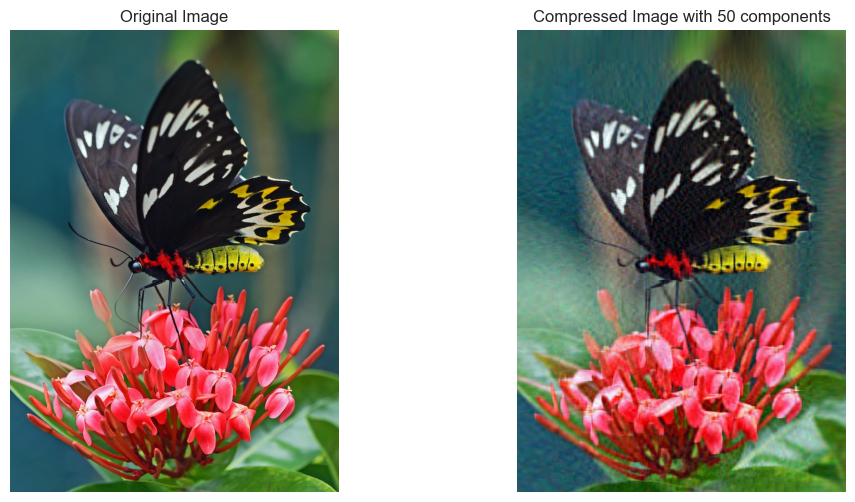

Number of components: 50
Explained variance ratios for R channel: 0.9678
Explained variance ratios for G channel: 0.9339
Explained variance ratios for B channel: 0.9368


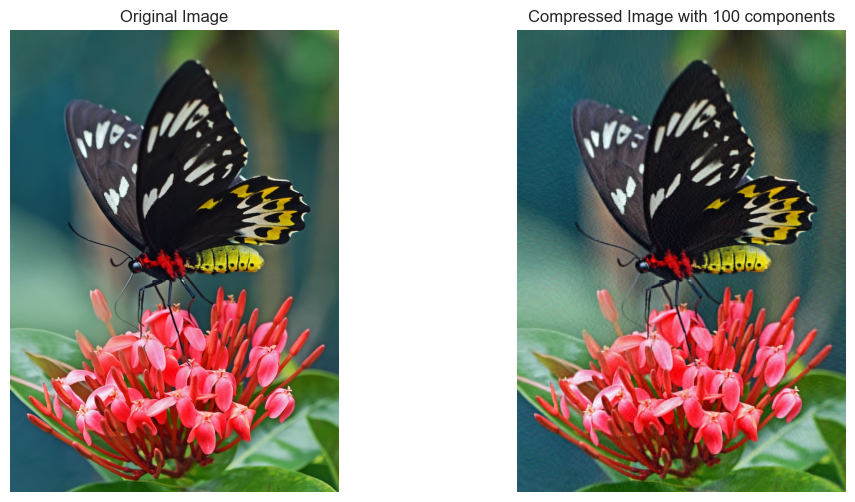

Number of components: 100
Explained variance ratios for R channel: 0.9909
Explained variance ratios for G channel: 0.9795
Explained variance ratios for B channel: 0.9799


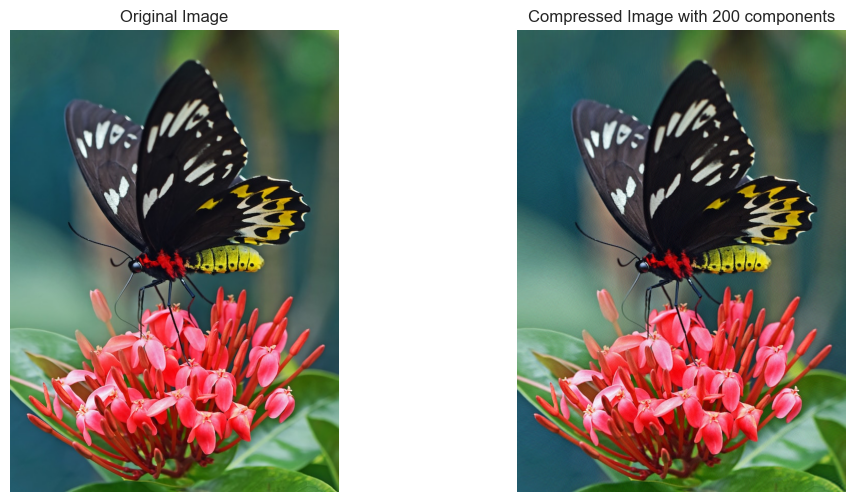

Number of components: 200
Explained variance ratios for R channel: 0.9983
Explained variance ratios for G channel: 0.9961
Explained variance ratios for B channel: 0.9960
Compressing image 2


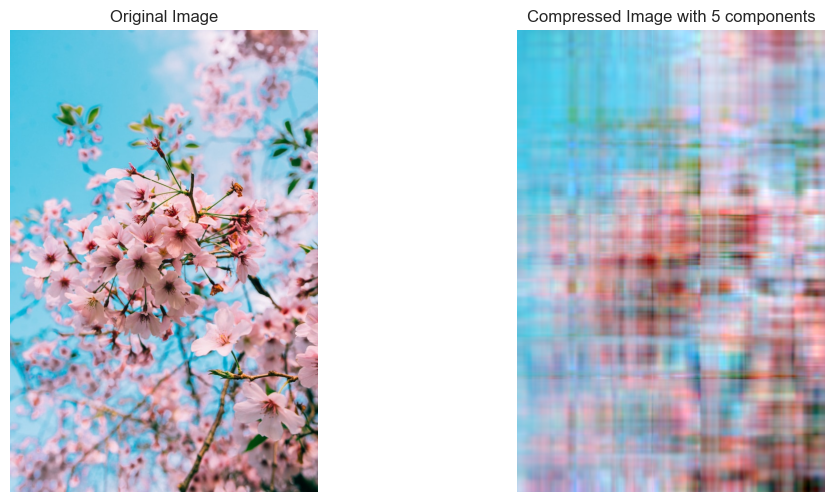

Number of components: 5
Explained variance ratios for R channel: 0.5253
Explained variance ratios for G channel: 0.5371
Explained variance ratios for B channel: 0.5249


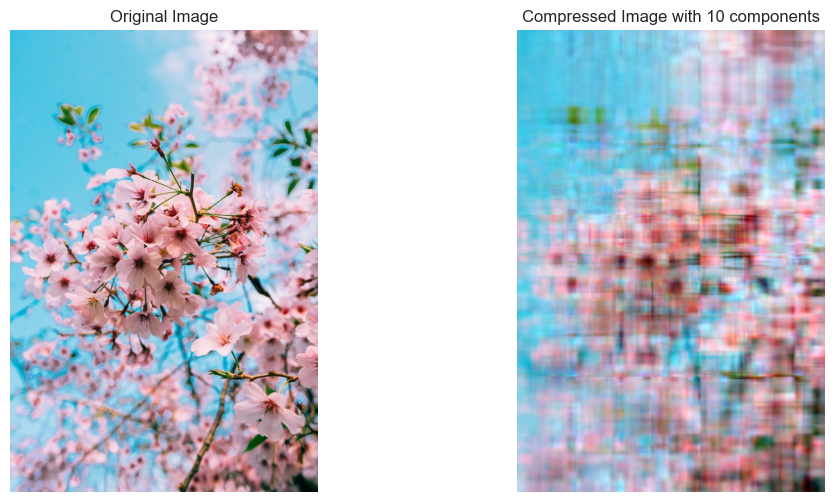

Number of components: 10
Explained variance ratios for R channel: 0.6656
Explained variance ratios for G channel: 0.6754
Explained variance ratios for B channel: 0.6698


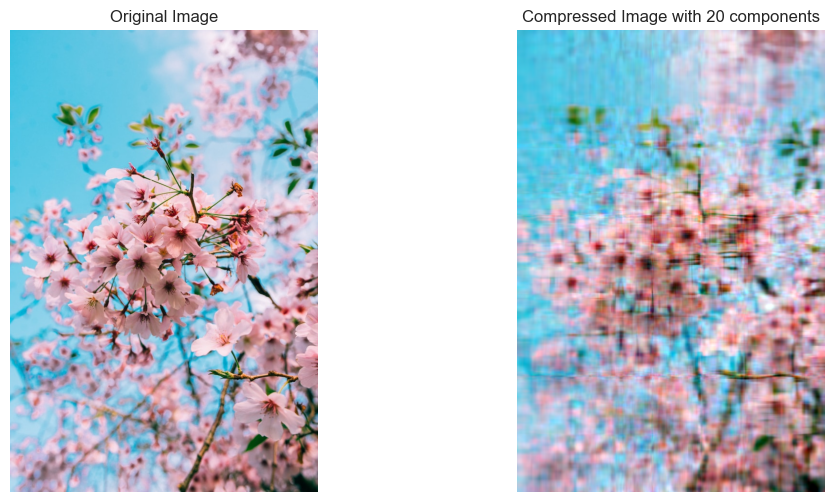

Number of components: 20
Explained variance ratios for R channel: 0.8163
Explained variance ratios for G channel: 0.8135
Explained variance ratios for B channel: 0.8142


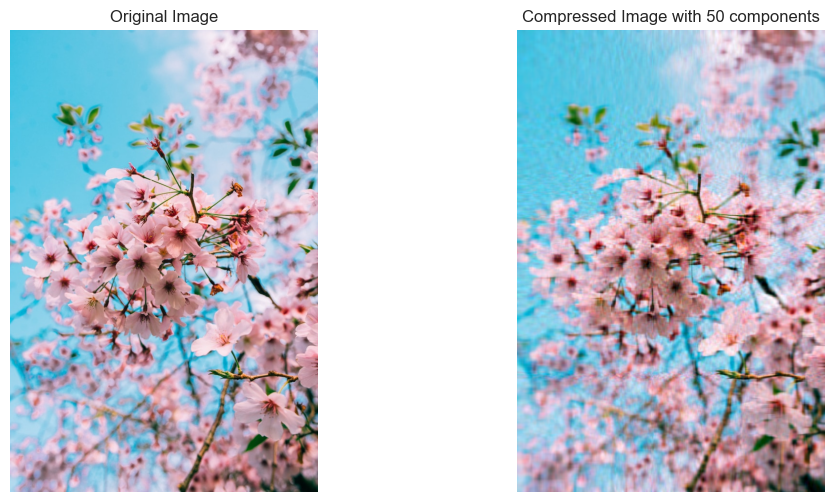

Number of components: 50
Explained variance ratios for R channel: 0.9490
Explained variance ratios for G channel: 0.9450
Explained variance ratios for B channel: 0.9496


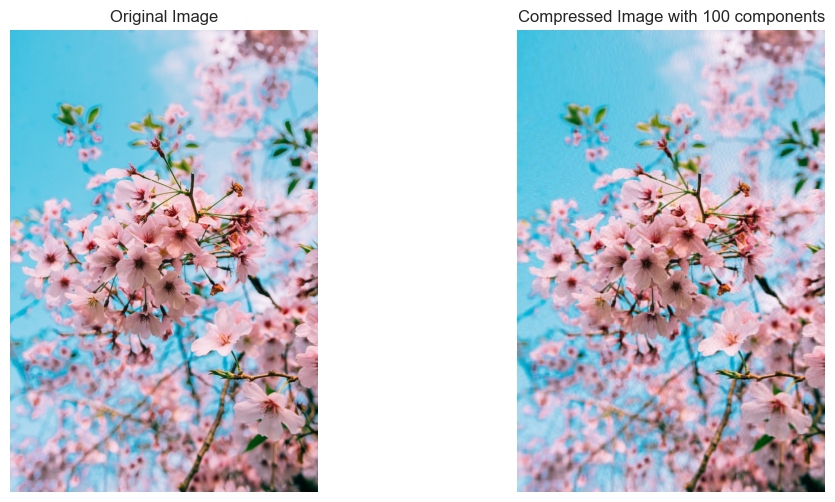

Number of components: 100
Explained variance ratios for R channel: 0.9873
Explained variance ratios for G channel: 0.9839
Explained variance ratios for B channel: 0.9876


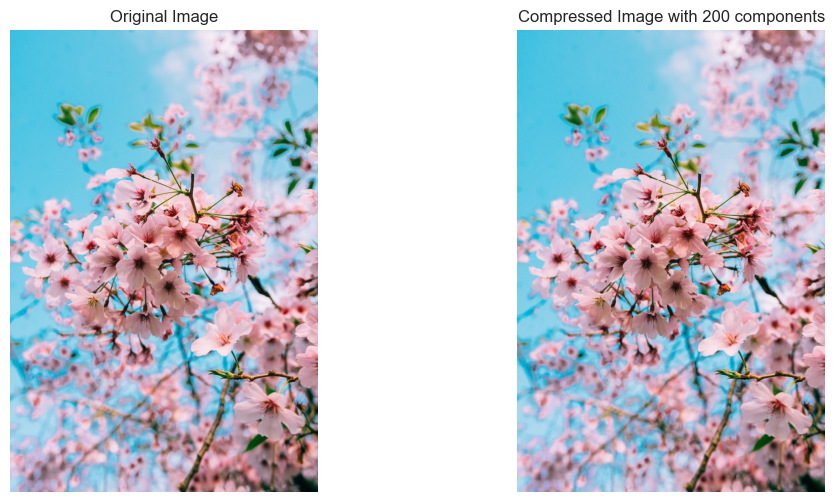

Number of components: 200
Explained variance ratios for R channel: 0.9982
Explained variance ratios for G channel: 0.9974
Explained variance ratios for B channel: 0.9983
Compressing image 3


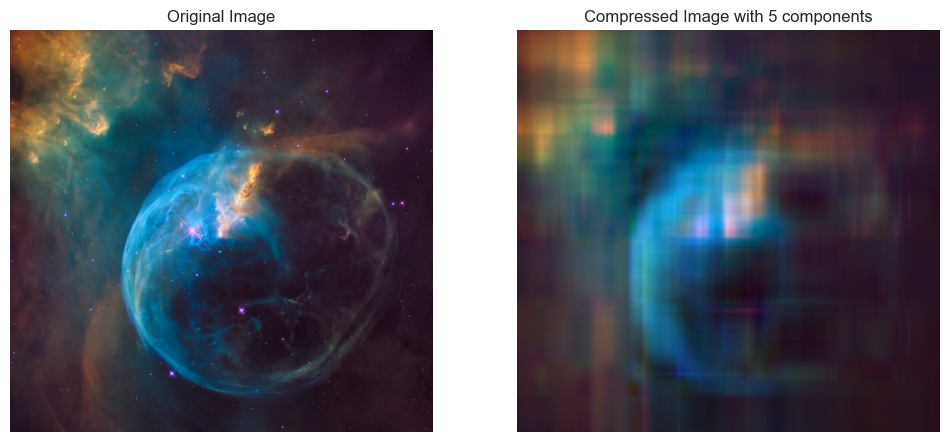

Number of components: 5
Explained variance ratios for R channel: 0.8247
Explained variance ratios for G channel: 0.8854
Explained variance ratios for B channel: 0.9040


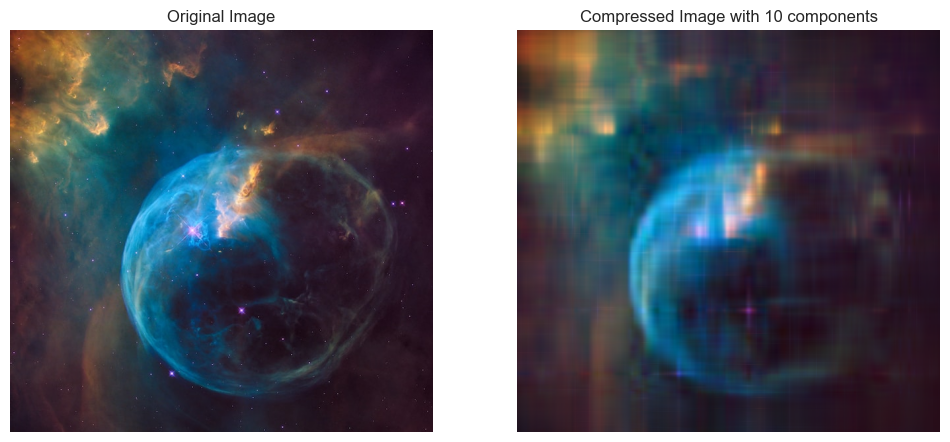

Number of components: 10
Explained variance ratios for R channel: 0.9093
Explained variance ratios for G channel: 0.9396
Explained variance ratios for B channel: 0.9495


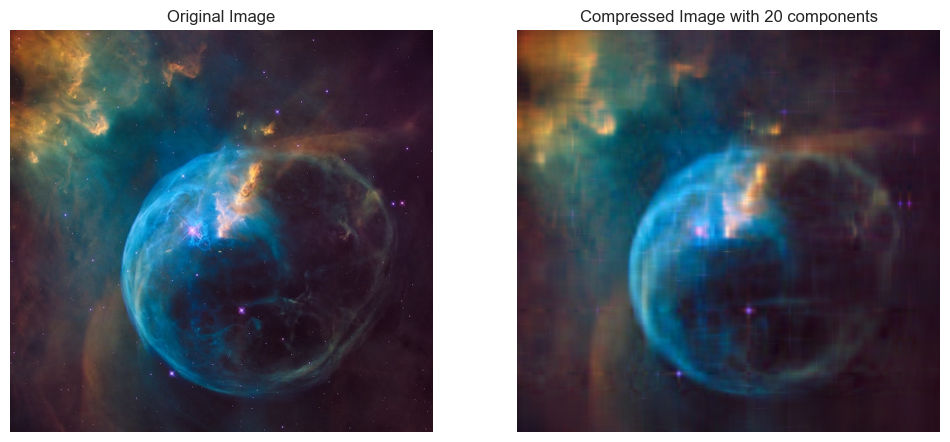

Number of components: 20
Explained variance ratios for R channel: 0.9533
Explained variance ratios for G channel: 0.9683
Explained variance ratios for B channel: 0.9736


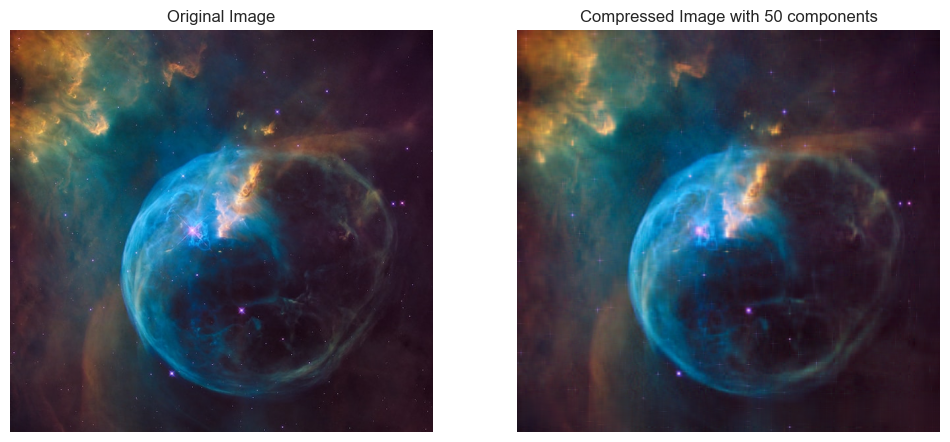

Number of components: 50
Explained variance ratios for R channel: 0.9823
Explained variance ratios for G channel: 0.9860
Explained variance ratios for B channel: 0.9880


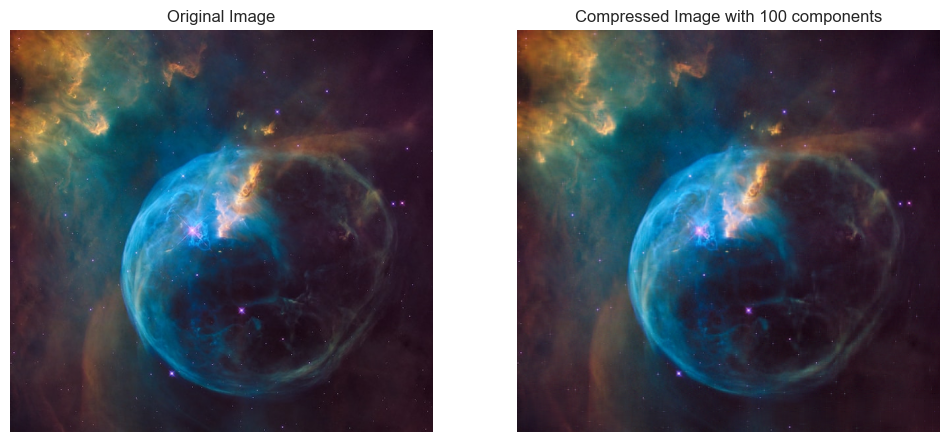

Number of components: 100
Explained variance ratios for R channel: 0.9925
Explained variance ratios for G channel: 0.9936
Explained variance ratios for B channel: 0.9944


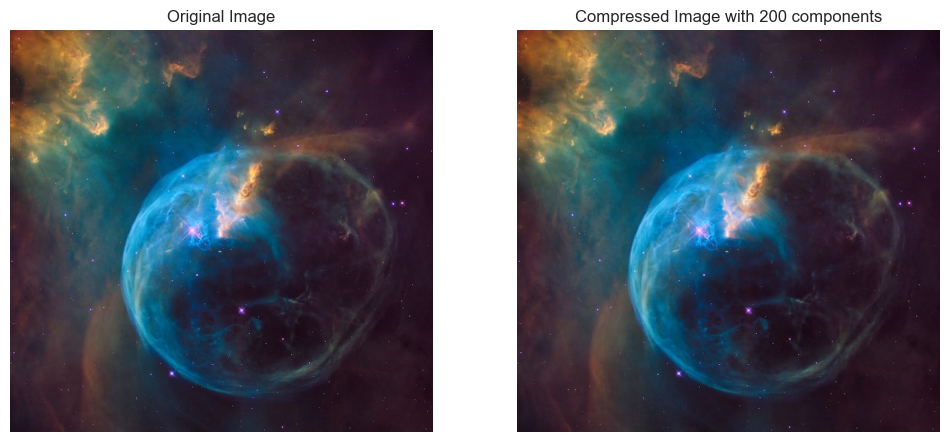

Number of components: 200
Explained variance ratios for R channel: 0.9982
Explained variance ratios for G channel: 0.9984
Explained variance ratios for B channel: 0.9985


In [24]:
from sklearn.decomposition import PCA

def apply_pca(image, n_components):
    # Separate the image into R, G, B channels
    R = image[:, :, 0]
    G = image[:, :, 1]
    B = image[:, :, 2]

    # Apply PCA to each channel
    pca_r = PCA(n_components=n_components)
    pca_g = PCA(n_components=n_components)
    pca_b = PCA(n_components=n_components)

    R_transformed = pca_r.fit_transform(R)
    G_transformed = pca_g.fit_transform(G)
    B_transformed = pca_b.fit_transform(B)

    R_inverted = pca_r.inverse_transform(R_transformed)
    G_inverted = pca_g.inverse_transform(G_transformed)
    B_inverted = pca_b.inverse_transform(B_transformed)

    # Reconstruct the image
    compressed_image = np.stack((R_inverted, G_inverted, B_inverted), axis=2)
    return compressed_image, pca_r, pca_g, pca_b

def plot_images(original, compressed, n_components):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(original.astype(np.uint8))
    axes[0].set_title('Original Image')
    axes[0].axis('off')

    axes[1].imshow(np.clip(compressed, 0, 255).astype(np.uint8))
    axes[1].set_title(f'Compressed Image with {n_components} components')
    axes[1].axis('off')

    plt.show()

def explained_variance_ratios(pca_r, pca_g, pca_b):
    ratios_r = np.cumsum(pca_r.explained_variance_ratio_)
    ratios_g = np.cumsum(pca_g.explained_variance_ratio_)
    ratios_b = np.cumsum(pca_b.explained_variance_ratio_)
    return ratios_r, ratios_g, ratios_b



# Number of components to try
components_list = [5, 10, 20, 50, 100, 200]

for i, image in enumerate(images):
    print(f"Compressing image {i+1}")
    for n_components in components_list:
        compressed_image, pca_r, pca_g, pca_b = apply_pca(image, n_components)
        plot_images(image, compressed_image, n_components)

        ratios_r, ratios_g, ratios_b = explained_variance_ratios(pca_r, pca_g, pca_b)
        print(f'Number of components: {n_components}')
        print(f'Explained variance ratios for R channel: {ratios_r[-1]:.4f}')
        print(f'Explained variance ratios for G channel: {ratios_g[-1]:.4f}')
        print(f'Explained variance ratios for B channel: {ratios_b[-1]:.4f}')


200 is almost perfectly showing the original image. I would say you can already see what the image displays after 10-20 components